# Transformada de Fourier

Para essa aula, utilizarei os conceitos disponíveis no vídeo https://youtu.be/spUNpyF58BY

Vamos supor dois sinais com frequências bem distintas. Se os sinais fossem enviados independentemente, seria fácil e simples determinar a frequência de cada um. Porém, o que normalmente acontece é que observamos a combinação dos dois ou mais sinais enviados, de forma que a função seja bastante complicada, se não impossível, de determinar as frequências, como mostrado no exemplo abaixo

In [1]:
import numpy as np
import astropy.units as u
import matplotlib.pyplot as plt

Text(0, 0.5, 'Freq. Combinadas')

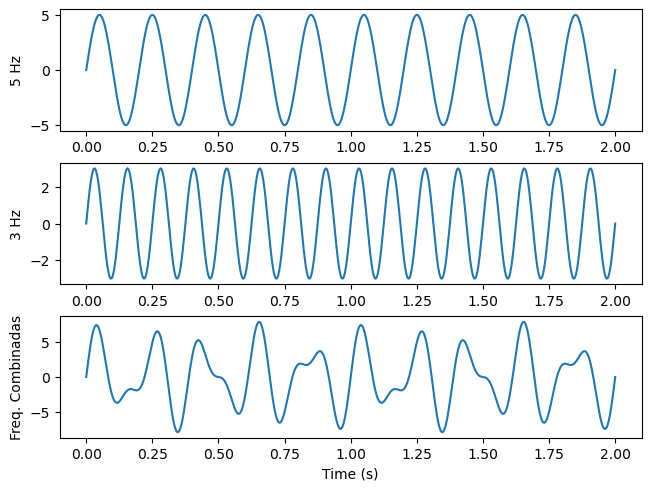

In [2]:
t = np.linspace(0,2,500)
h1 = 5*np.sin(2*np.pi*5*t)
h2 = 3*np.sin(2*np.pi*8*t)
fig, axs = plt.subplots(3, 1, layout='constrained')
axs[0].plot(t, h1)
axs[1].plot(t, h2)
axs[2].plot(t, h1+h2)
axs[2].set_xlabel('Time (s)')
axs[0].set_ylabel('5 Hz')
axs[1].set_ylabel('3 Hz')
axs[2].set_ylabel('Freq. Combinadas')

Como poderíamos obter as frequências destes sinais?

Para responder esta pergunta vamos testar o sinal recebido com outro sinal e visualizá-lo no plano xy. Como teste, utilizaremos o sinal h1 acima com a frequência de 5Hz. Vamos supor que não conhecemos a frequência original e testar com a frequência de 3 Hz.

In [3]:
f = 3 # Hertz
x = h1*np.cos(2*np.pi*f*t)
y = h1*np.sin(2*np.pi*f*t)

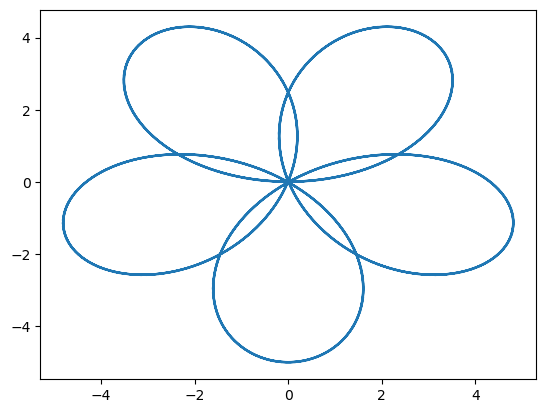

In [4]:
plt.plot(x,y)

Note que, neste caso, é desenhado uma figura simétrica ao redor da origem. Isso se deve à diferença de frequência entre a emitida e a gerada. Se calcularmos o ponto médio destes pontos vamos notar que eles ficam próximos à origem, apesar dos pontos se distanciarem até 4 unidades da origem.

In [5]:
print(x.mean(), y.mean())

2.0783375020982932e-16 -4.014566457044566e-16


Podemos fazer o mesmo teste para uma outra frequência qualquer.

0.19890826289041869 -0.24043878661520113


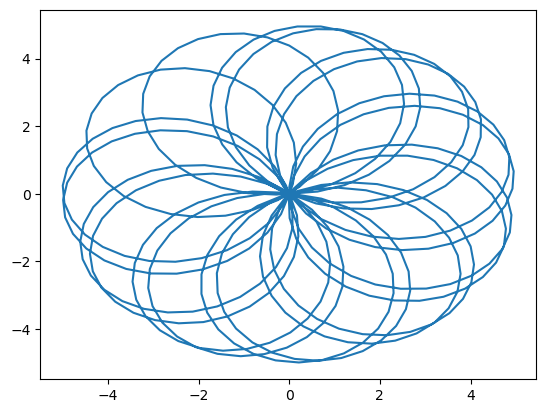

In [6]:
f = 4.11 # Hertz
x = h1*np.cos(2*np.pi*f*t)
y = h1*np.sin(2*np.pi*f*t)
plt.plot(x,y)
print(x.mean(), y.mean())

Agora, a figura ainda circula ao redor da origem, mas o valor médio dos pontos se afasta um pouco da origem. O que aconteceria se tentássemos com o valor correto de frequência

2.540190280342358e-16 2.495000000000002


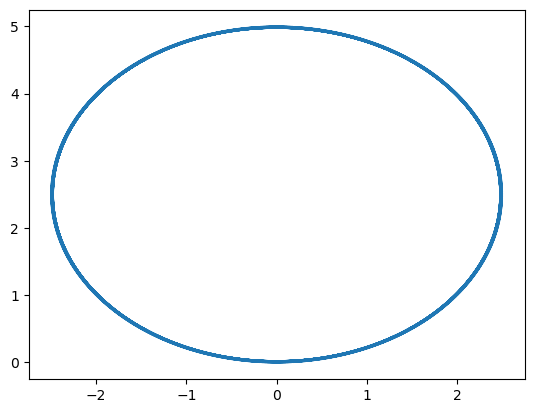

In [7]:
f = 5 # Hertz
x = h1*np.cos(2*np.pi*f*t)
y = h1*np.sin(2*np.pi*f*t)
plt.plot(x,y)
print(x.mean(), y.mean())

Com o valor correto, a figura, apesar de simétrica, não circula mais a origem, estando um pouco afastada na vertical. Calculando o valor médio, a média se distancia de 2.495 unidades. Com isso, podemos concluir que o afastamento do valor médio da origem é um indicativo da frequência correta. Para verificarmos, vamos testar para várias frequências e fazer um gráfico desta distância em função da frequência.

In [8]:
# Vamos testar 1000 valores de frequências entre 0 e 10.
nf = np.linspace(0,10,1000)
# H é a lista que guardará os valores médios para cada frequência.
H = np.zeros(len(nf))
for i in range(len(nf)):
    x = h1*np.cos(2*np.pi*nf[i]*t)
    y = h1*np.sin(2*np.pi*nf[i]*t)
    H[i] = np.sqrt(x.mean()**2 + y.mean()**2)

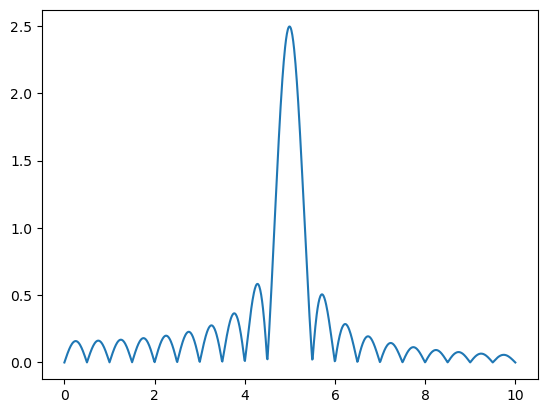

In [9]:
plt.plot(nf, H)

Realmente, testando para várias frequências, a maior distância ocorre para a frequência correta.

Vamos fazer uma animação mostrando as linhas e o centro em função da frequência

In [10]:
from matplotlib import animation
from IPython.display import HTML

FPS=20
fig = plt.figure(figsize=(5, 5), dpi=100)

ax = plt.axes(xlim=(-5.1, 5.1), ylim=(-5.1, 5.1))
ax.set_aspect('equal')
ax.axis('off')

# Define os elementos da animação
linha, = ax.plot([], [], 'b')  # Cria o desenho dos pontos
centro, = ax.plot([], [], 'ro')  # Cria um ponto para o centro
texto = ax.text(4.3, 4.5, '')  # Cria um texto para a frequência

framesNum = len(nf)

def animate(j):
    """ Função de animação. Ela será chamada para cada frame
    
    Parameters
    ----------
    j : int
        Número do frame
    """
    x = h1*np.cos(2*np.pi*nf[j]*t)
    y = h1*np.sin(2*np.pi*nf[j]*t)
    linha.set_data(x, y)
    centro.set_data(x.mean(), y.mean())
    texto.set_text('f={:5.2f} Hz'.format(nf[j]))

anim = animation.FuncAnimation(fig, animate, frames=framesNum, interval=1000/FPS)
plt.close(anim._fig)
HTML(anim.to_html5_video())

/tmp/ipykernel_21192/1570131488.py:29: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  centro.set_data(x.mean(), y.mean())


Agora, vamos aplicar o método desenvolvido para o sinal que combina as duas oscilações

In [11]:
h = h1 + h2

nf = np.linspace(0,10,1000)
H = np.zeros(len(nf))
for i in range(len(nf)):
    x = h*np.cos(2*np.pi*nf[i]*t)
    y = h*np.sin(2*np.pi*nf[i]*t)
    H[i] = np.sqrt(x.mean()**2 + y.mean()**2)

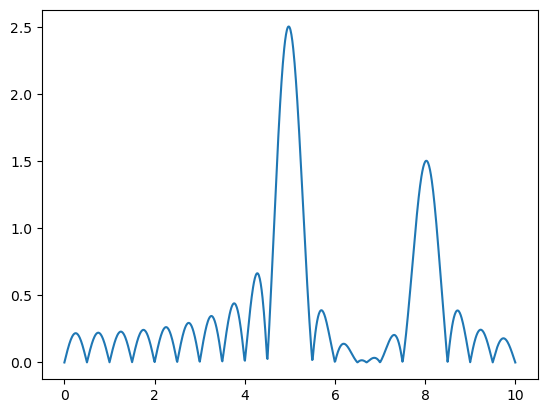

In [12]:
plt.plot(nf, H)

O método foi capaz de detectar as duas principais frequências.

Para finalizar, vamos aplicar o método a dados simulados não contínuos.

Vamos gerar 100 pontos aleatórios entre os segundos 0 e 100, ou seja, com um ponto a cada 100 segundos em média. A frequência utilizada será de 5Hz, portanto, em média haverá 1 ponto a cada 5 oscilações. Não é fácil visualizar a oscilação.

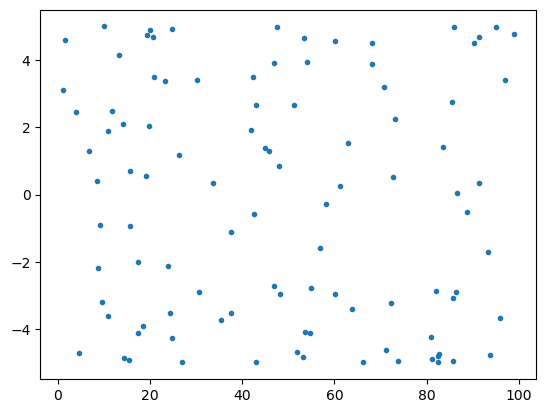

In [13]:
t = np.random.uniform(0,100,100)
h = 5*np.sin(2*np.pi*5*t)
plt.plot(t, h, '.')

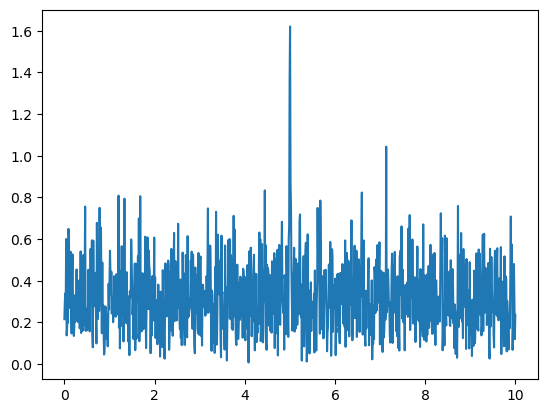

In [14]:
# Aplicando a metodologia
nf = np.linspace(0,10,1000)
H = np.zeros(len(nf))
for i in range(len(nf)):
    x = h*np.cos(2*np.pi*nf[i]*t)
    y = h*np.sin(2*np.pi*nf[i]*t)
    H[i] = np.sqrt(x.mean()**2 + y.mean()**2)
plt.plot(nf, H)

In [15]:
print(nf[np.argmax(H)])

5.005005005005005


Note que, apesar do grande ruído, que se deve ao pouco número de pontos utilizados, o método ainda foi capaz de determinar a frequência que melhor ajusta todos os pontos.